# LIME for Heart Attack Analysis models

In this work I will explain predictions obtained from a Random Forest model and a Logistic Regression model. I will use
Local Interpretable Model-agnostic Explanations (**LIME**) implementations from the Python framework `lime`. Dataset
used is The Heart Attack Analysis dataset
([source](https://www.kaggle.com/datasets/rashikrahmanpritom/heart-attack-analysis-prediction-dataset)).

Dataset attributes:

- Age : Age of the patient
- Sex : Sex of the patient
- exang: exercise induced angina (1 = yes; 0 = no)
- caa: number of major vessels (0-3)
- cp : Chest Pain type
    - Value 1: typical angina
    - Value 2: atypical angina
    - Value 3: non-anginal pain
    - Value 4: asymptomatic
- trtbps : resting blood pressure (in mm Hg)
- chol : cholestoral in mg/dl fetched via BMI sensor
- fbs : (fasting blood sugar > 120 mg/dl) (1 = true; 0 = false)
- rest_ecg : resting electrocardiographic results
    - Value 0: normal
    - Value 1: having ST-T wave abnormality (T wave inversions and/or ST elevation or depression of > 0.05 mV)
    - Value 2: showing probable or definite left ventricular hypertrophy by Estes' criteria
- thalach : maximum heart rate achieved
- oldpeak : Previous peak
- slp : Slope
- target : 0= less chance of heart attack 1= more chance of heart attack
- thall : Thalium Stress Test result [0, 3]

I have preprocessed the dataset by one hot encoding categorical features.

## Feature correlation matrix

![correlation_matrix](imgs/correlation_matrix.png)

Correlation matrix shows the highest influence on the output from `thall_2`, `thalachh` and `slp_2`.

## Compare LIME for various observations in the dataset.
![imgs/lime_2_seed_0](imgs/lime_2_seed_0.png)
![imgs/lime_2_seed_1](imgs/lime_2_seed_1.png)
![imgs/lime_2_seed_2](imgs/lime_2_seed_2.png)
![imgs/lime_3_seed_0](imgs/lime_3_seed_0.png)
![imgs/lime_3_seed_1](imgs/lime_3_seed_1.png)
![imgs/lime_3_seed_2](imgs/lime_3_seed_2.png)

I have run the explainer on the same samples for 3 different seeds. We can see that the seed does not have a big impact
on the results both on the sample 203 and sample 246. There are differences in importance but not significant.
We can see that label `thall_2` (Thalium Stress Test result value 2 from [0, 3]) is the most important feature for both
samples which might indicate high success rate of this particular medical test. Another important feature is `halach`
(heart rate) which for non-expert is easiest to correlate with chance of heart attack.

## Compare LIME with the explanations obtained using SHAP
![imgs/lime_2_seed_0](imgs/lime_2_seed_0.png)
![imgs/lime_3_seed_0](imgs/lime_3_seed_0.png)
![dx_task_3](imgs/dx_task_3.png)

I compare LIME from `lime` package to SHAP from `dalex` package. `thall_2` is the most important feature for both
samples and both explainers which is not surprising as the `thall_2` feature has the highest correlation with `output`
of all features. Both explainers have similar result, but what is worth
noting is that for sample 203 SHAP marked `oldpeak` as one of the most important features which is not included in top
10 most important features from LIME. Additionally LIME ranked `caa_x` features high which is not that important in
SHAP explanations.

## Compare LIME between at least two different models.
![imgs/lime_2_seed_0](imgs/lime_2_seed_0.png)
![imgs/lr_lime_2](imgs/lr_lime_2.png)

LIME assigns highly different importance between features for Random Forest model and Logistic Regression model.
Nonetheless all shared top features for both models have the same attribution sign (positive/negative). For Logistic
Regression model contrary to Random Forest model LIME does not find the 'thalachh` feature important, this might be
due to the fact that the data is not normalized and Regression model does not adapt well to the variable with values in
this range - [71, 202].


## Appendix

### Install required packages.

In [1]:
%%capture
%pip install dalex jinja2 kaleido lime numpy nbformat pandas plotly torch scikit-learn shap

### Imports and loading dataset

In [2]:
import dalex as dx
import lime
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import plotly.express as px
import shap
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import RidgeClassifier
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

rng = np.random.default_rng(0)

TARGET_COLUMN = "output"
df = pd.read_csv("heart.csv")
df.describe()

/home/krystian/PythonProjects/eXplainableMachineLearning-2023/.venv/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


,age,sex,cp,trtbps,chol,fbs,restecg,thalachh,exng,oldpeak,slp,caa,thall,output
count,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000
mean,54.366337,0.683168,0.966997,131.623762,246.264026,0.148515,0.528053,149.646865,0.326733,1.039604,1.399340,0.729373,2.313531,0.544554
std,9.082101,0.466011,1.032052,17.538143,51.830751,0.356198,0.525860,22.905161,0.469794,1.161075,0.616226,1.022606,0.612277,0.498835
min,29.000000,0.000000,0.000000,94.000000,126.000000,0.000000,0.000000,71.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,47.500000,0.000000,0.000000,120.000000,211.000000,0.000000,0.000000,133.500000,0.000000,0.000000,1.000000,0.000000,2.000000,0.000000
50%,55.000000,1.000000,1.000000,130.000000,240.000000,0.000000,1.000000,153.000000,0.000000,0.800000,1.000000,0.000000,2.000000,1.000000
75%,61.000000,1.000000,2.000000,140.000000,274.500000,0.000000,1.000000,166.000000,1.000000,1.600000,2.000000,1.000000,3.000000,1.000000
max,77.000000,1.000000,3.000000,200.000000,564.000000,1.000000,2.000000,202.000000,1.000000,6.200000,2.000000,4.000000,3.000000,1.000000


Shuffling the data, extracting target column and one hot encoding categorical columns..

In [3]:
df = df.sample(frac=1, random_state=0).reset_index(drop=True)

y = df[[TARGET_COLUMN]]

x = df.drop(TARGET_COLUMN, axis=1)

categorical_cols = ["sex", "cp", "fbs", "restecg", "exng", "slp", "caa", "thall"]
numerical_cols = list(set(x.columns) - set(categorical_cols))

x = pd.get_dummies(x, columns=categorical_cols, drop_first=True)
n_columns = len(x.columns)

categorical_cols, numerical_cols

(['sex', 'cp', 'fbs', 'restecg', 'exng', 'slp', 'caa', 'thall'],
 ['oldpeak', 'thalachh', 'trtbps', 'age', 'chol'])

## Correlation matrix

Not being an expert in cardiology I plot correlation matrix to have a view how each column impacts the target.

In [4]:
corr_df = x.copy()
corr_df[TARGET_COLUMN] = y

corr = corr_df.corr("pearson")
corr.style.background_gradient(cmap='coolwarm')

,age,trtbps,chol,thalachh,oldpeak,sex_1,cp_1,cp_2,cp_3,fbs_1,restecg_1,restecg_2,exng_1,slp_1,slp_2,caa_1,caa_2,caa_3,caa_4,thall_1,thall_2,thall_3,output
age,1.000000,0.279351,0.213678,-0.398522,0.210013,-0.098447,-0.147399,-0.059432,0.047516,0.121308,-0.160654,0.084621,0.096801,0.177201,-0.192580,0.179284,0.226491,0.162243,-0.122378,0.063758,-0.135891,0.110752,-0.225439
trtbps,0.279351,1.000000,0.123174,-0.046698,0.193216,-0.056769,-0.081851,-0.045107,0.151343,0.177531,-0.146576,0.058635,0.067616,0.025207,-0.087472,-0.059485,0.088386,0.080109,0.019059,0.076369,-0.140712,0.109573,-0.144931
chol,0.213678,0.123174,1.000000,-0.009940,0.053952,-0.197912,-0.012750,-0.037918,-0.050589,0.013294,-0.174394,0.034615,0.067023,0.051177,-0.028054,0.018775,0.059887,0.098568,-0.095785,-0.093560,-0.004591,0.059621,-0.085239
thalachh,-0.398522,-0.046698,-0.009940,1.000000,-0.344187,-0.044020,0.248317,0.165475,0.079082,-0.008567,0.101512,-0.120870,-0.378812,-0.419627,0.448043,-0.195502,-0.056905,-0.175506,0.060911,-0.159748,0.294801,-0.215417,0.421741
oldpeak,0.210013,0.193216,0.053952,-0.344187,1.000000,0.096093,-0.277513,-0.132444,0.086959,0.005747,-0.138486,0.168172,0.288223,0.310986,-0.511356,-0.011613,0.218319,0.189296,-0.104998,0.104635,-0.339086,0.302145,-0.430696
sex_1,-0.098447,-0.056769,-0.197912,-0.044020,0.096093,1.000000,-0.041249,-0.116588,0.088043,0.045032,-0.011940,-0.107689,0.141664,-0.009157,-0.014356,0.096673,-0.020571,0.066758,0.088212,0.141135,-0.376365,0.321559,-0.280937
cp_1,-0.147399,-0.081851,-0.012750,0.248317,-0.277513,-0.041249,1.000000,-0.282135,-0.127412,-0.060649,0.105226,-0.051418,-0.233863,-0.197994,0.223921,-0.059046,-0.087804,-0.082372,0.012208,-0.036496,0.207354,-0.188225,0.245879
cp_2,-0.059432,-0.045107,-0.037918,0.165475,-0.132444,-0.116588,-0.282135,1.000000,-0.181894,0.083679,0.092738,-0.009492,-0.271028,-0.105320,0.120276,0.023753,-0.196274,-0.021817,0.089577,-0.097775,0.210130,-0.173717,0.316742
cp_3,0.047516,0.151343,-0.050589,0.079082,0.086959,0.088043,-0.127412,-0.181894,1.000000,0.055511,-0.063252,-0.033150,-0.093384,0.009321,-0.044421,-0.058710,0.041972,-0.076192,-0.037125,0.033404,0.009998,-0.022554,0.086957
fbs_1,0.121308,0.177531,0.013294,-0.008567,0.005747,0.045032,-0.060649,0.083679,0.055511,1.000000,-0.066344,-0.048305,0.025665,-0.033360,-0.020255,-0.014774,0.122080,0.075867,0.018754,0.091351,-0.086774,0.030953,-0.028046


## Random Forest model

In [5]:
model = RandomForestClassifier(random_state=0).fit(x, y)

accuracy_score(y, model.predict(x))

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().


1.0

## Sample selection

In [6]:
sample_ids = [42, 81, 203, 246]
df.iloc[sample_ids]

,age,sex,cp,trtbps,chol,fbs,restecg,thalachh,exng,oldpeak,slp,caa,thall,output
42,52,1,2,138,223,0,1,169,0,0.0,2,4,2,1
81,64,1,0,120,246,0,0,96,1,2.2,0,1,2,0
203,45,1,3,110,264,0,1,132,0,1.2,1,0,3,0
246,35,0,0,138,183,0,1,182,0,1.4,2,0,2,1


## Lime explainer

In [7]:
lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=x.values,  
    feature_names=x.columns,
    mode="classification",
)

In [8]:
lime_explanations = [lime_explainer.explain_instance(
    data_row=x.iloc[i],
    predict_fn=lambda d: model.predict_proba(d)
) for i in sample_ids]

X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names


## One sample explanation

In [9]:
lime_explanations[0].as_list()

[('0.00 < thall_2 <= 1.00', 0.17091997509330514),
 ('caa_1 <= 0.00', 0.11041495590152198),
 ('caa_2 <= 0.00', 0.10959504689258537),
 ('thall_3 <= 0.00', 0.10481807440253335),
 ('0.00 < cp_2 <= 1.00', 0.079692744584465),
 ('thalachh > 166.00', 0.07691810188069735),
 ('exng_1 <= 0.00', 0.07609213868944184),
 ('oldpeak <= 0.00', 0.0724095038394936),
 ('caa_3 <= 0.00', 0.055132483953900704),
 ('0.00 < sex_1 <= 1.00', -0.050473934025983755)]

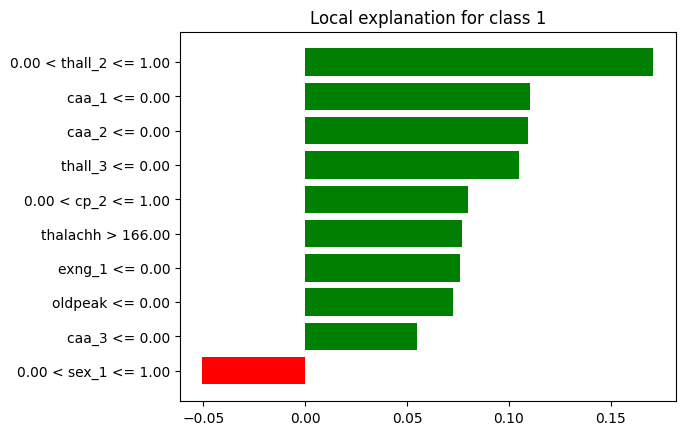

In [10]:
_ = lime_explanations[0].as_pyplot_figure()

In [11]:
_ = lime_explanations[0].show_in_notebook()

In [12]:
def plot_explanation(lime_explanation, filename, title):
    _ = lime_explanation.show_in_notebook()
    _ = lime_explanation.as_pyplot_figure()
    plt.title(title)
    plt.savefig(filename, bbox_inches='tight')

X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names


X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names


X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names
X does not have valid feature names, but RandomForestClassifier was fitted with feature names


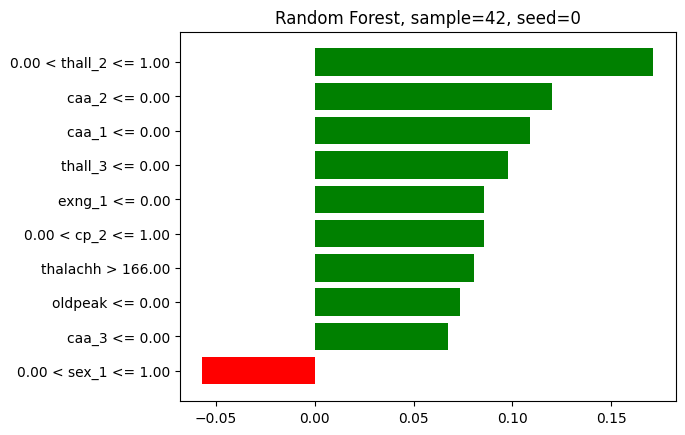

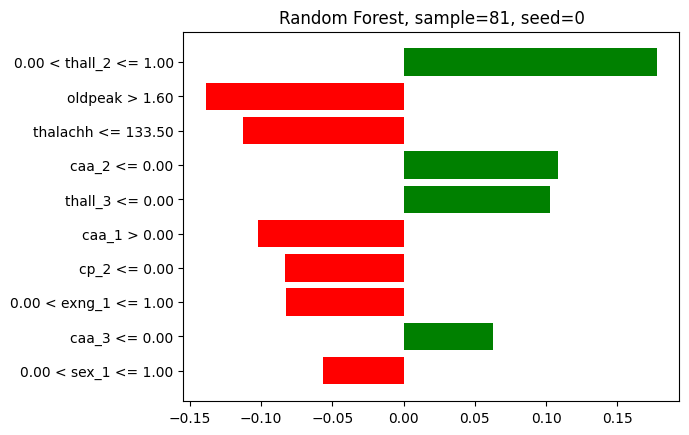

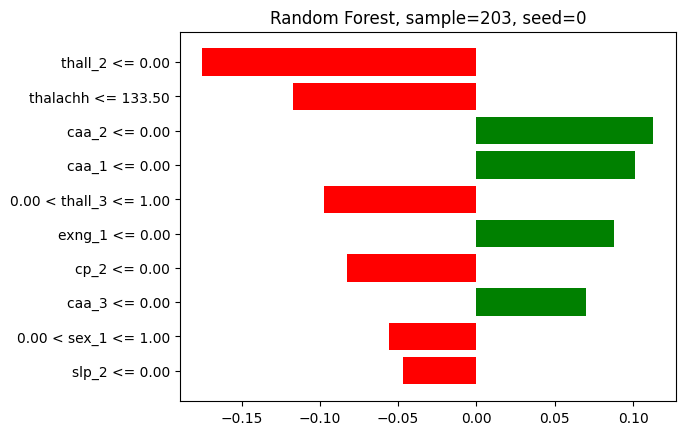

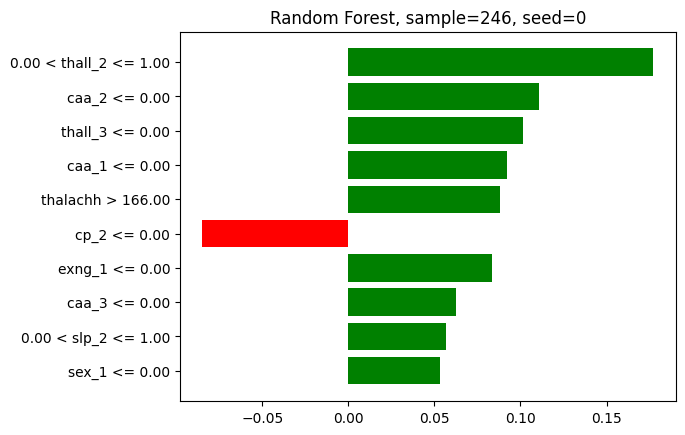

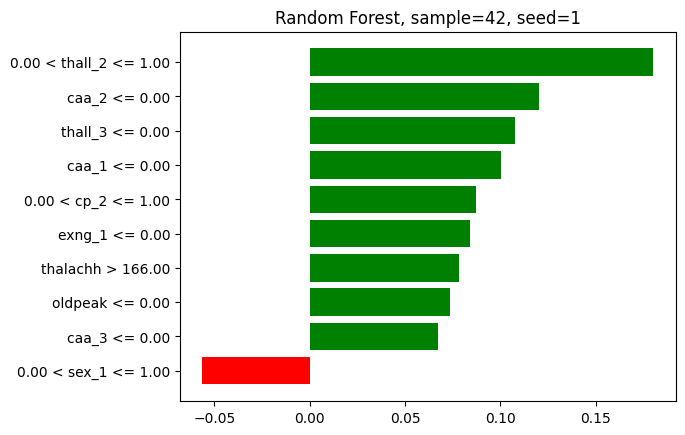

...

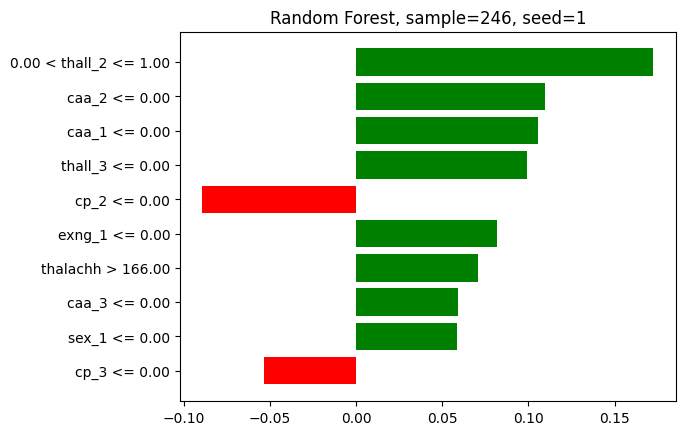

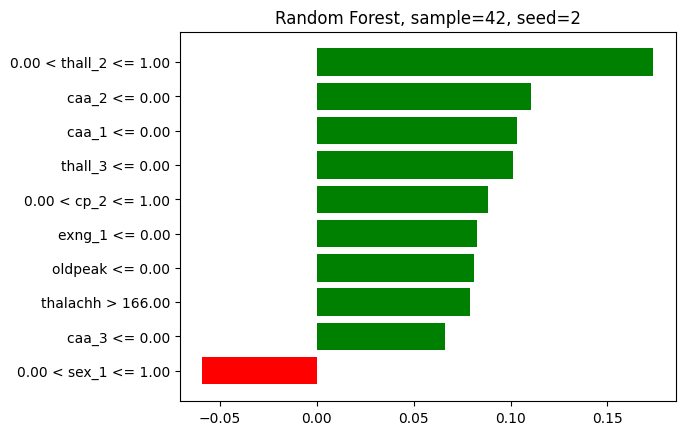

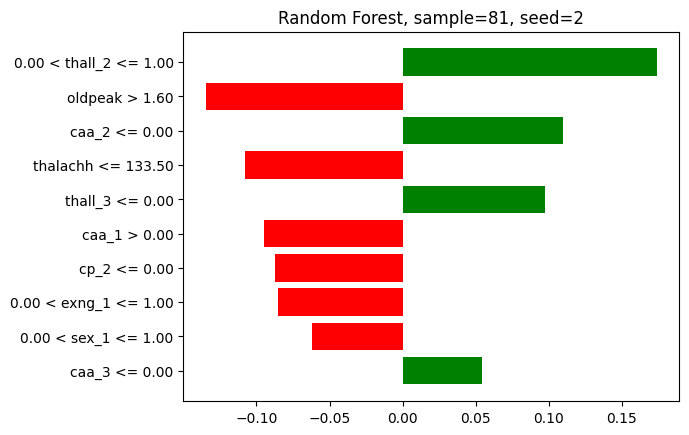

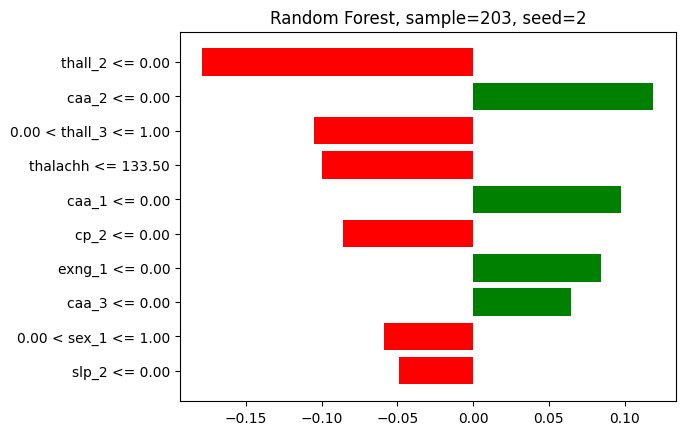

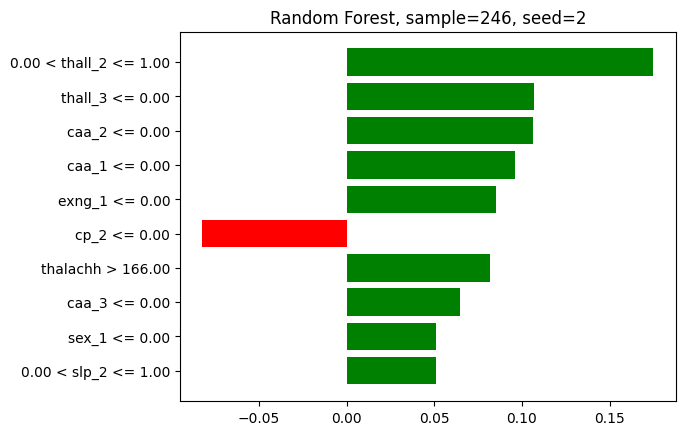

In [13]:
def explain(seed):
    lime_explainer = lime.lime_tabular.LimeTabularExplainer(
        training_data=x.values,  
        feature_names=x.columns,
        mode="classification",
        random_state=seed
    )

    lime_explanations = [lime_explainer.explain_instance(
        data_row=x.iloc[i],
        predict_fn=lambda d: model.predict_proba(d)
    ) for i in sample_ids]

    for id, lime_explanation in enumerate(lime_explanations):
        plot_explanation(lime_explanation, f"imgs/lime_{id}_seed_{seed}.png", f"Random Forest, sample={sample_ids[id]}, seed={seed}")

for seed in range(3):
    explain(seed)

## Another model - Logistic Regression

In [14]:
lr_clf = RidgeClassifier(random_state=0).fit(x, y.squeeze())

accuracy_score(y, lr_clf.predict(x))

0.8778877887788779

In [15]:
def lr_predict_func(d):
    pred = lr_clf.decision_function(d)
    res = 1 / (1 + np.exp(-pred))
    return np.array([1 - res, res]).T

lr_lime_explanations = [lime_explainer.explain_instance(
    data_row=x.iloc[i],
    predict_fn=lr_predict_func
) for i in sample_ids]

X does not have valid feature names, but RidgeClassifier was fitted with feature names
X does not have valid feature names, but RidgeClassifier was fitted with feature names
X does not have valid feature names, but RidgeClassifier was fitted with feature names
X does not have valid feature names, but RidgeClassifier was fitted with feature names


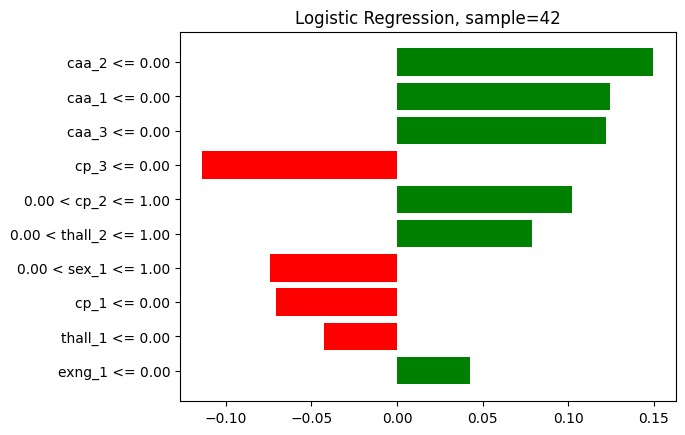

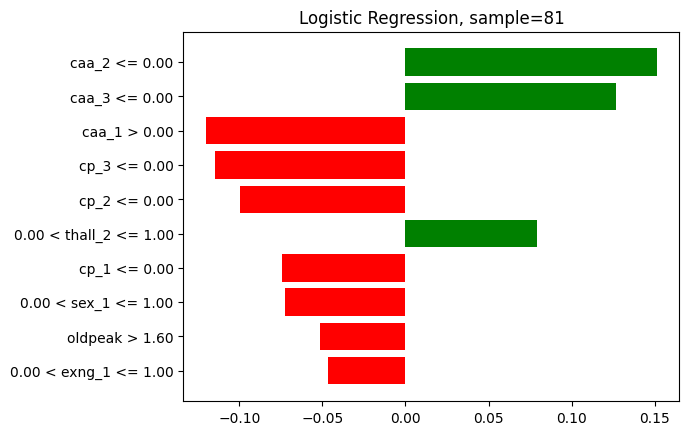

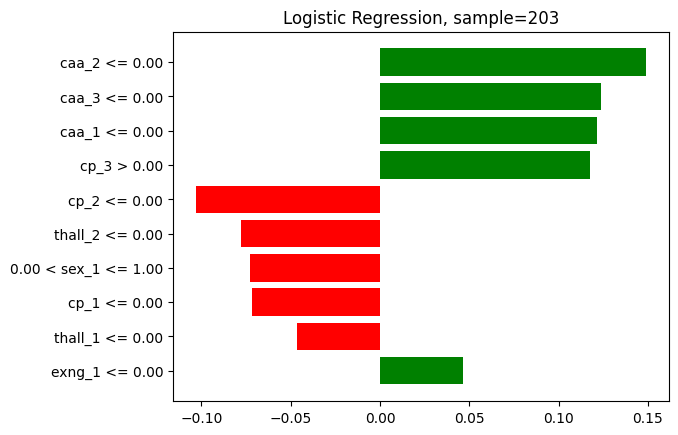

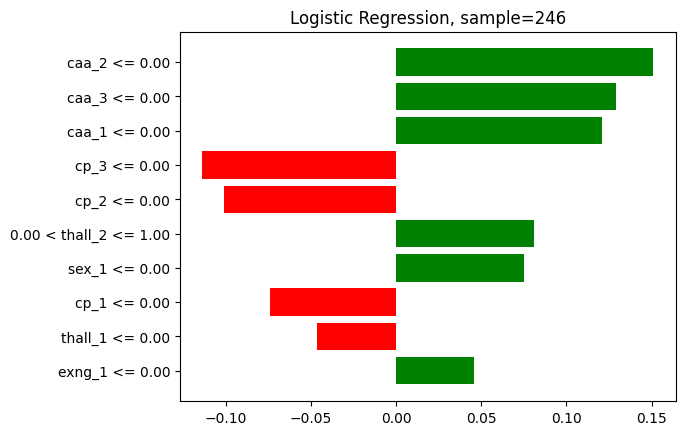

In [16]:
for id, lime_explanation in enumerate(lr_lime_explanations):
    plot_explanation(lime_explanation, f"imgs/lr_lime_{id}.png", f"Logistic Regression, sample={sample_ids[id]}")